<a href="https://colab.research.google.com/github/Abhiram-k1/Abhi-opensource-GIT-/blob/main/Amith_and_group.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import zipfile
zip_path = '/content/drive/MyDrive/new_archive.zip'
extract_to ='/content/drive/MyDrive/extracted_files'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)
print(f"Files extracted to {extract_to}")

Files extracted to /content/drive/MyDrive/extracted_files


In [ ]:
#1.Read and Explore CSV File
from google.colab import drive
import zipfile
import os
drive.mount('/content/drive')
zip_path = '/content/drive/MyDrive/archive (1).zip'
extract_to = '/content/drive/MyDrive/extracted_files'
if not os.path.exists(zip_path):
    print(f"Error: Zip file not found at {zip_path}")
else:
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)
    print(f"Files extracted to {extract_to}")
    extracted_folder_pcos = '/content/drive/MyDrive/extracted_files/dataset/pcos'
    extracted_folder_normal = '/content/drive/MyDrive/extracted_files/dataset/normal'
    def count_images_in_folder(folder_path):
        if not os.path.exists(folder_path):
            print(f"Error: Folder not found at {folder_path}")
            return 0
        extracted_files = os.listdir(folder_path)
        image_count = 0
        for file_name in extracted_files:
            if file_name.lower().endswith(('.jpg', '.jpeg', '.png')):
                image_count += 1
        return image_count
    pcos_image_count = count_images_in_folder(extracted_folder_pcos)
    normal_image_count = count_images_in_folder(extracted_folder_normal)
    total_image_count = pcos_image_count + normal_image_count
    print(f"Total Images in PCOS folder: {pcos_image_count}")
    print(f"Total Images in Normal folder: {normal_image_count}")
    print(f"Total Images in the dataset: {total_image_count}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Error: Zip file not found at /content/drive/MyDrive/archive (1).zip


Processing images in pcos folder...


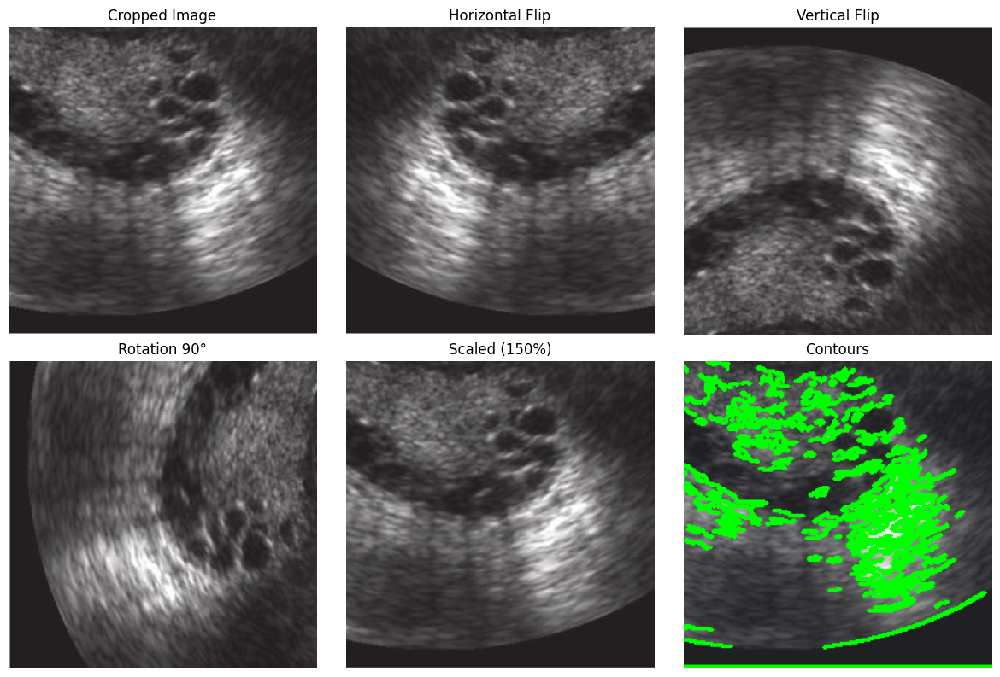

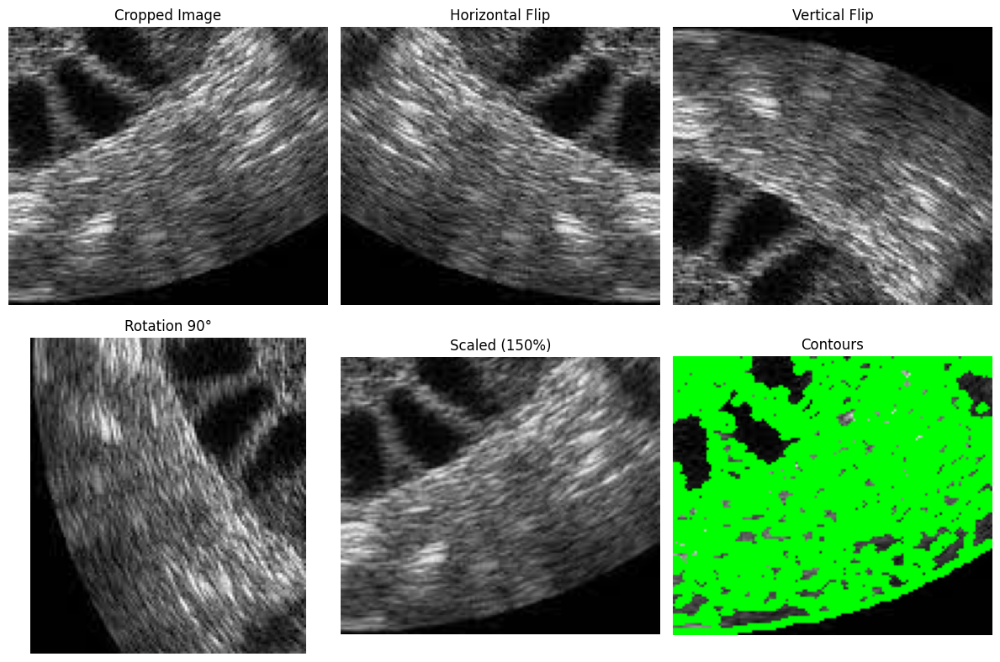

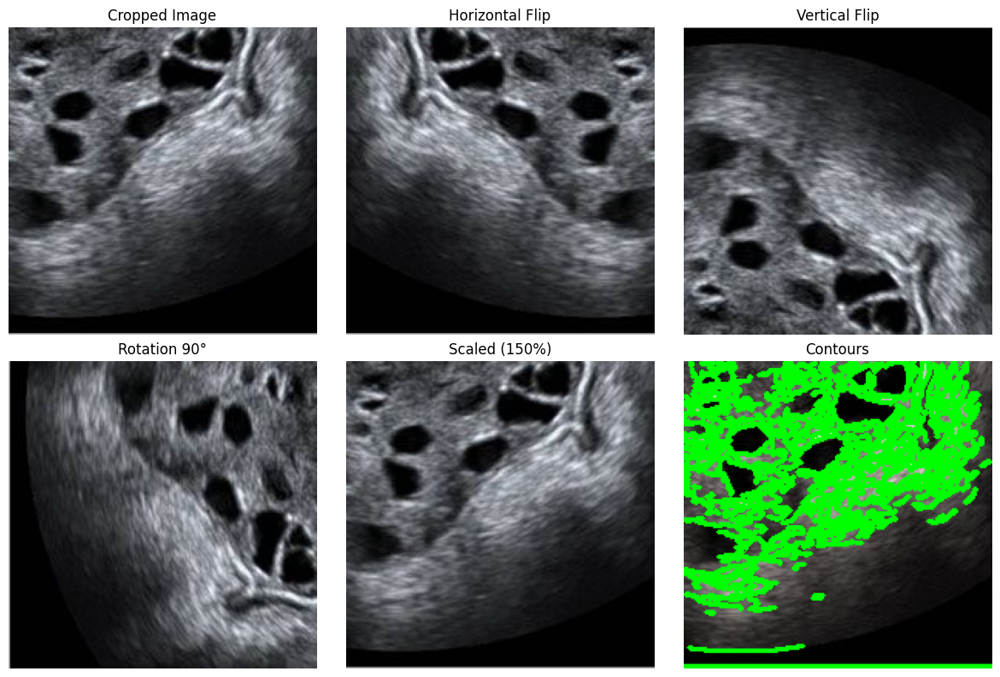

KeyboardInterrupt: 

In [ ]:
#2.Image Preprocessing and Augmentation
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
class OvarianImagePreprocessor:
    def __init__(self, image_path):
        self.image = cv2.imread(image_path)
    def crop_image(self, x, y, w, h):
        return self.image[y:y+h, x:x+w]

    def augment_image(self, cropped_image):
        augmented_images = {}
        augmented_images['horizontal_flip'] = cv2.flip(cropped_image, 1)
        augmented_images['vertical_flip'] = cv2.flip(cropped_image, 0)
        augmented_images['rotation_90'] = cv2.rotate(cropped_image, cv2.ROTATE_90_CLOCKWISE)
        augmented_images['scaling_150'] = cv2.resize(cropped_image, None, fx=1.5, fy=1.5)
        return augmented_images

    def edge_detection(self, cropped_image):
        gray_image = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2GRAY)
        # Apply Canny edge detection
        return cv2.Canny(gray_image, 100, 200)

    def draw_contours(self, cropped_image, edges):
        # Find contours in the image
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # Draw the contours on the original image
        contour_image = cv2.drawContours(cropped_image.copy(), contours, -1, (0, 255, 0), 2)
        return contour_image

    def visualize(self, cropped_image, augmented_images, edges, contour_image):
        # Display images
        fig, axes = plt.subplots(2, 3, figsize=(12, 8))
        axes[0, 0].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[0, 0].set_title("Cropped Image")
        axes[0, 0].axis('off')

        axes[0, 1].imshow(cv2.cvtColor(augmented_images['horizontal_flip'], cv2.COLOR_BGR2RGB))
        axes[0, 1].set_title("Horizontal Flip")
        axes[0, 1].axis('off')

        axes[0, 2].imshow(cv2.cvtColor(augmented_images['vertical_flip'], cv2.COLOR_BGR2RGB))
        axes[0, 2].set_title("Vertical Flip")
        axes[0, 2].axis('off')

        axes[1, 0].imshow(cv2.cvtColor(augmented_images['rotation_90'], cv2.COLOR_BGR2RGB))
        axes[1, 0].set_title("Rotation 90°")
        axes[1, 0].axis('off')

        axes[1, 1].imshow(cv2.cvtColor(augmented_images['scaling_150'], cv2.COLOR_BGR2RGB))
        axes[1, 1].set_title("Scaled (150%)")
        axes[1, 1].axis('off')

        axes[1, 2].imshow(contour_image)
        axes[1, 2].set_title("Contours")
        axes[1, 2].axis('off')

        plt.tight_layout()
        plt.show()
def process_images_in_directory(directory_path):
    for filename in os.listdir(directory_path):

        if filename.endswith(".jpg") or filename.endswith(".png"):
            image_path = os.path.join(directory_path, filename)
            preprocessor = OvarianImagePreprocessor(image_path)
            cropped_image = preprocessor.crop_image(100, 100, 300, 300)
            augmented_images = preprocessor.augment_image(cropped_image)
            edges = preprocessor.edge_detection(cropped_image)
            contour_image = preprocessor.draw_contours(cropped_image, edges)
            preprocessor.visualize(cropped_image, augmented_images, edges, contour_image)
def process_dataset(Dataset_Dir):
    class_folders = ['pcos', 'normal']

    for class_folder in class_folders:
        class_path = os.path.join(Dataset_Dir, class_folder)
        if os.path.isdir(class_path):
            print(f"Processing images in {class_folder} folder...")
            process_images_in_directory(class_path)
        else:
            print(f"Folder {class_folder} not found!")
def main():
    dataset_directory = '/content/drive/MyDrive/extracted_files/dataset/'
    process_dataset(dataset_directory)
if __name__ == "__main__":
    main()

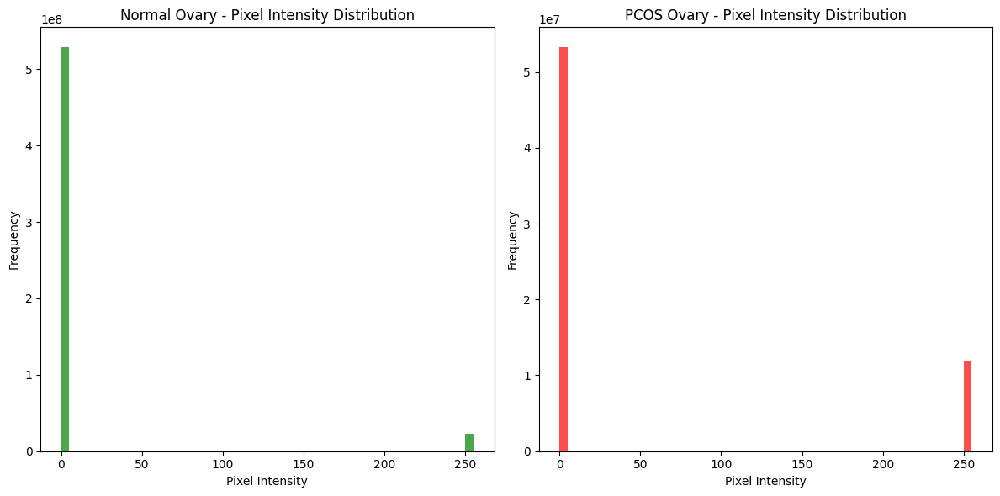

In [ ]:
#3. Compare Pixel Intensity (Normal vs. PCOS)
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2


class ImageProcessor:
    def __init__(self, normal_directory, pcos_directory):
        self.normal_directory = normal_directory
        self.pcos_directory = pcos_directory
        self.normal_images = [f for f in os.listdir(self.normal_directory) if f.endswith(('.jpg', '.png'))]
        self.pcos_images = [f for f in os.listdir(self.pcos_directory) if f.endswith(('.jpg', '.png'))]

    def process_image(self, image_path):
        # Read the image in grayscale
        img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        if img is None:
            raise ValueError(f"Failed to load image: {image_path}")
        # Normalize the image
        binary = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)[1]
        return img, binary

    def compare_original_augmented(self):
        # Process normal images
        normal_images_data = []
        for normal_image_path in self.normal_images:
            normal_image_path = os.path.join(self.normal_directory, normal_image_path)
            normal_img, normal_binary = self.process_image(normal_image_path)
            normal_images_data.append(normal_binary.flatten())

        if not normal_images_data:
            raise ValueError("No valid normal images were processed.")
        normal_data_flat = np.concatenate(normal_images_data)

        # Process PCOS images
        pcos_images_data = []
        for pcos_image_path in self.pcos_images:
            pcos_image_path = os.path.join(self.pcos_directory, pcos_image_path)
            pcos_img, pcos_binary = self.process_image(pcos_image_path)
            pcos_images_data.append(pcos_binary.flatten())

        if not pcos_images_data:
            raise ValueError("No valid PCOS images were processed.")
        pcos_data_flat = np.concatenate(pcos_images_data)

        # Plot histograms
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))

        axes[0].hist(normal_data_flat, bins=50, color='green', alpha=0.7)
        axes[0].set_title("Normal Ovary - Pixel Intensity Distribution")
        axes[0].set_xlabel("Pixel Intensity")
        axes[0].set_ylabel("Frequency")

        axes[1].hist(pcos_data_flat, bins=50, color='red', alpha=0.7)
        axes[1].set_title("PCOS Ovary - Pixel Intensity Distribution")
        axes[1].set_xlabel("Pixel Intensity")
        axes[1].set_ylabel("Frequency")

        plt.tight_layout()
        plt.show()

# Example Usage
normal_directory = '/content/drive/MyDrive/extracted_files/dataset/normal'
pcos_directory = '/content/drive/MyDrive/extracted_files/dataset/pcos'

processor = ImageProcessor(normal_directory, pcos_directory)
processor.compare_original_augmented()


<ipython-input-21-4bd09970da56>:55: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()  # Prevent overlapping


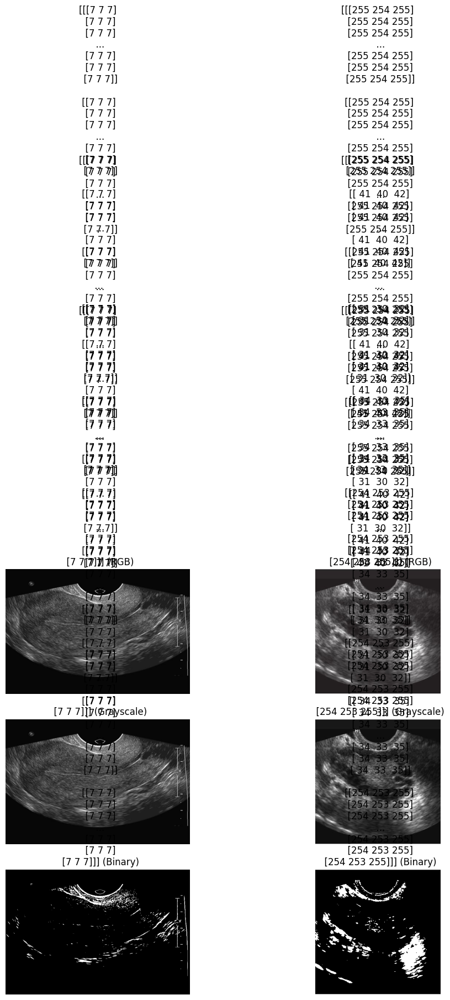

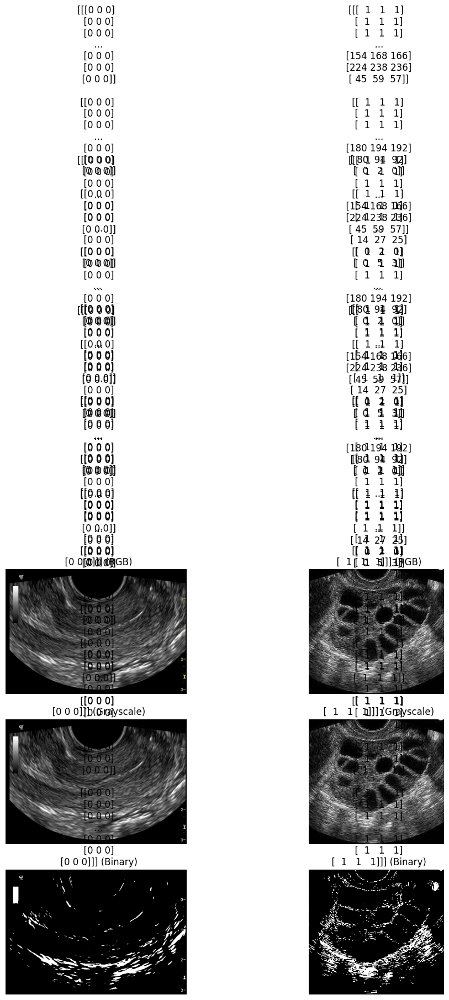

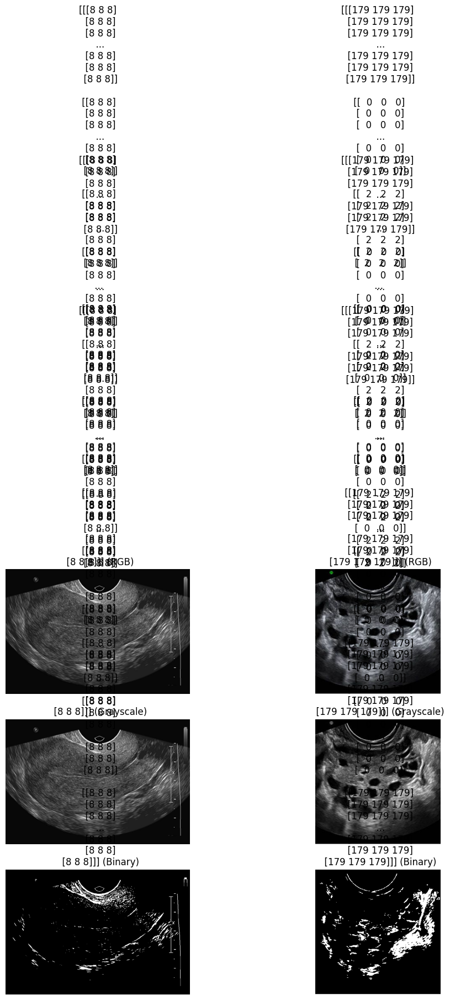

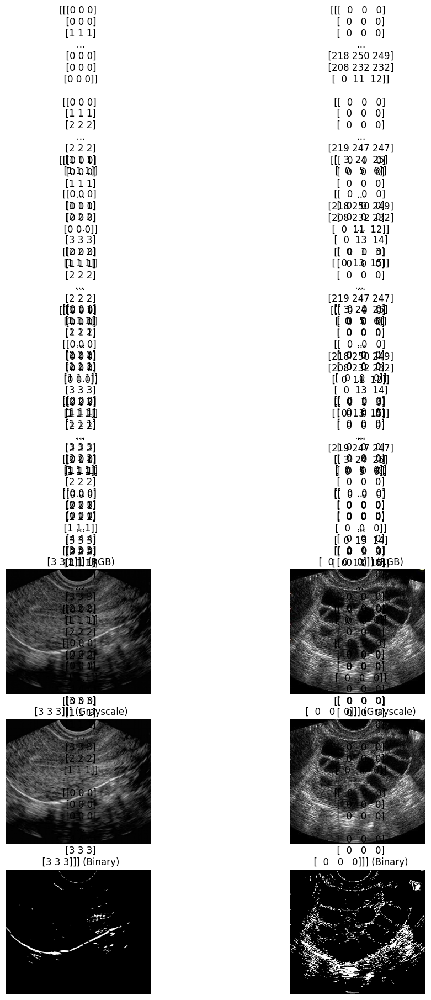

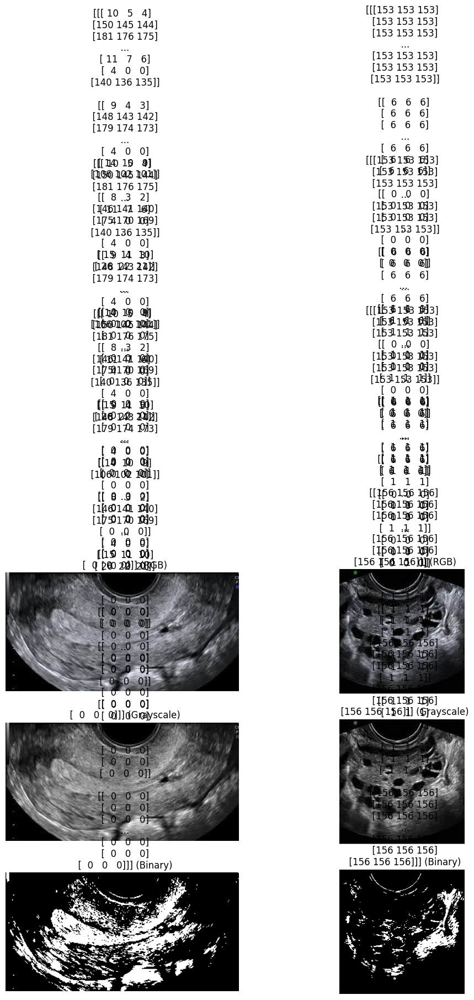

...

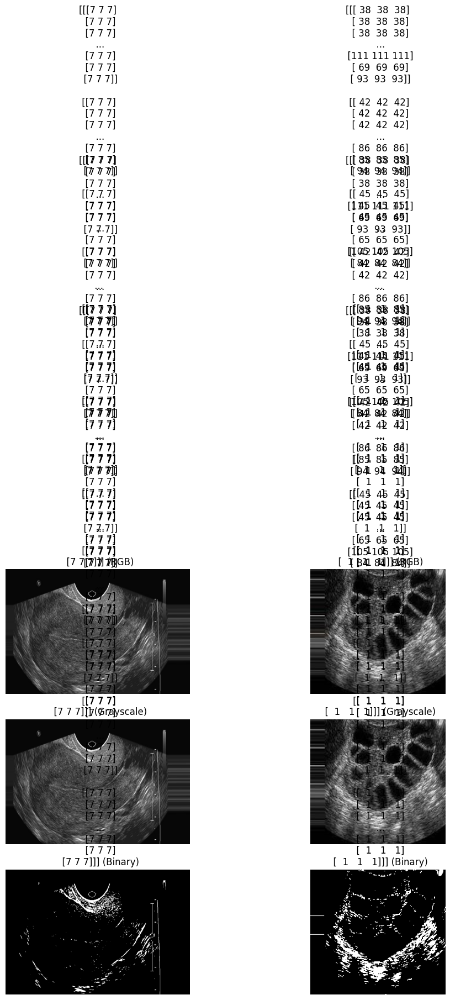

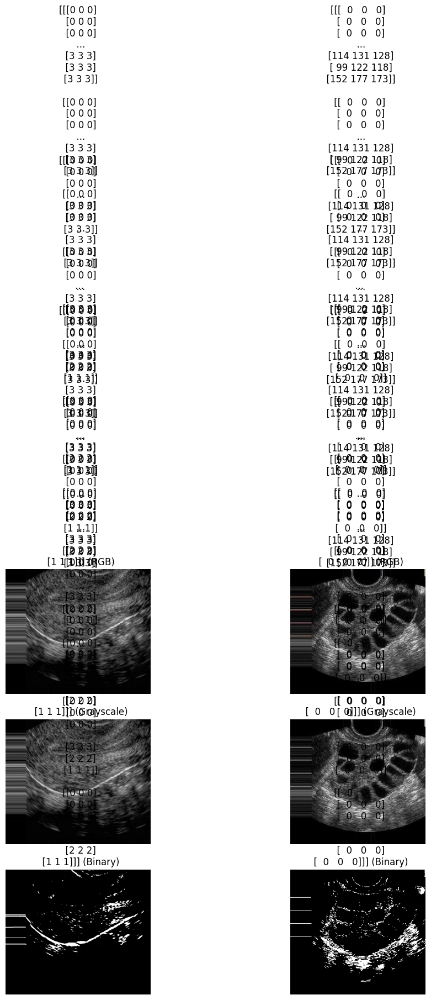

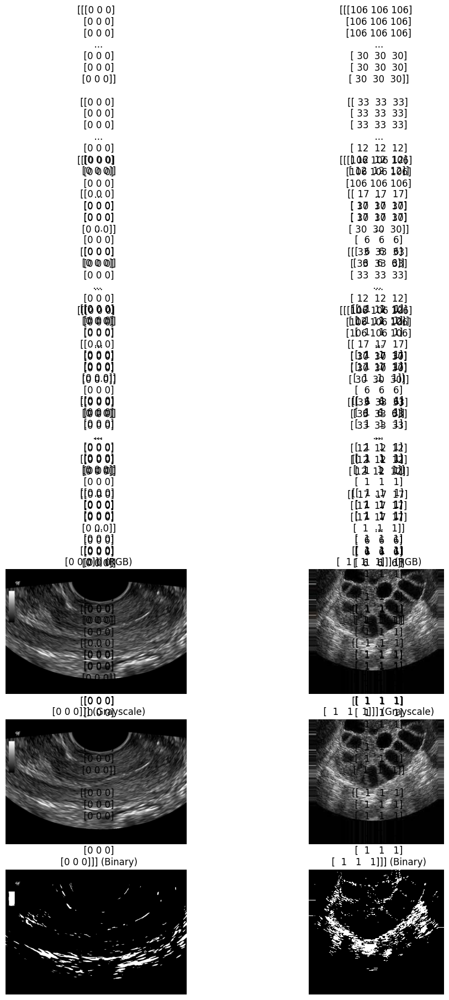

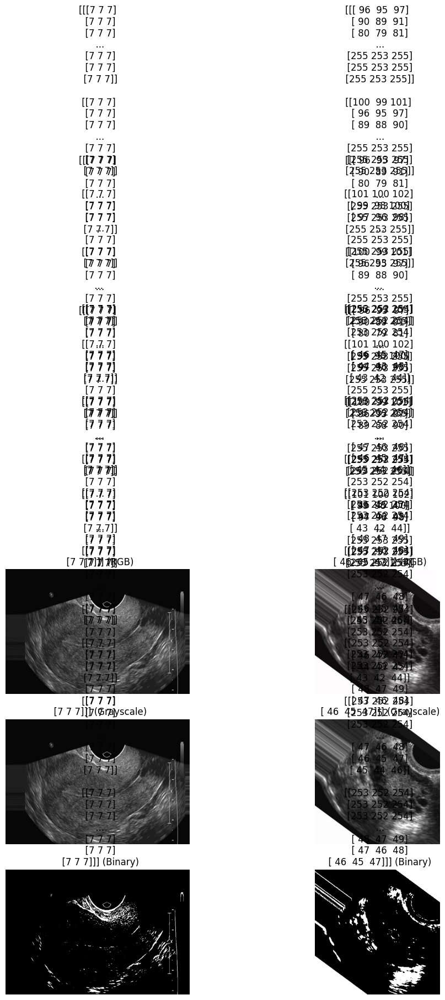

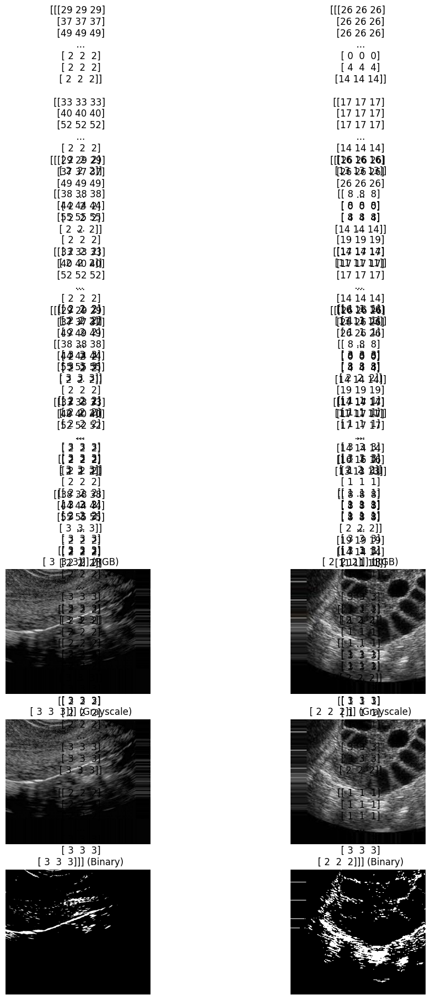

KeyboardInterrupt: 

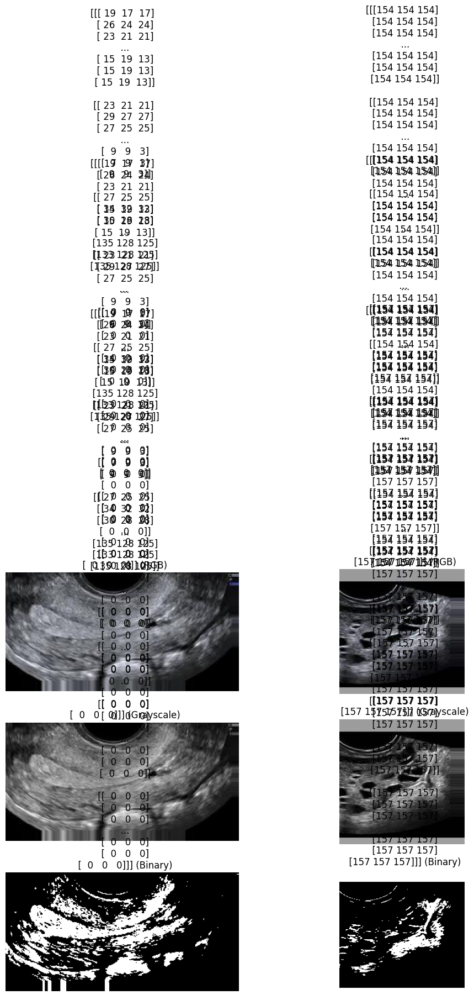

In [ ]:
#4. Image Transformation (Normal and PCOS)
import cv2
import matplotlib.pyplot as plt
import os

def process_images_in_directory(normal_directory, pcos_directory):
    normal_images = sorted(os.listdir(normal_directory))
    pcos_images = sorted(os.listdir(pcos_directory))

    for normal_image, pcos_image in zip(normal_images, pcos_images):
        normal_image_path = os.path.join(normal_directory, normal_image)
        pcos_image_path = os.path.join(pcos_directory, pcos_image)

        # Read images
        normal_image = cv2.imread(normal_image_path)
        pcos_image = cv2.imread(pcos_image_path)

        # Convert images to grayscale
        normal_gray = cv2.cvtColor(normal_image, cv2.COLOR_BGR2GRAY)
        pcos_gray = cv2.cvtColor(pcos_image, cv2.COLOR_BGR2GRAY)

        # Threshold to create binary images
        _, normal_binary = cv2.threshold(normal_gray, 127, 255, cv2.THRESH_BINARY)
        _, pcos_binary = cv2.threshold(pcos_gray, 127, 255, cv2.THRESH_BINARY)

        # Create a plot
        fig, axes = plt.subplots(3, 2, figsize=(12, 10))

        # Display images without overlapping
        axes[0, 0].imshow(cv2.cvtColor(normal_image, cv2.COLOR_BGR2RGB))
        axes[0, 0].set_title(f'{normal_image} (RGB)')
        axes[0, 0].axis('off')  # Hide axis

        axes[0, 1].imshow(cv2.cvtColor(pcos_image, cv2.COLOR_BGR2RGB))
        axes[0, 1].set_title(f'{pcos_image} (RGB)')
        axes[0, 1].axis('off')  # Hide axis

        axes[1, 0].imshow(normal_gray, cmap='gray')
        axes[1, 0].set_title(f'{normal_image} (Grayscale)')
        axes[1, 0].axis('off')  # Hide axis

        axes[1, 1].imshow(pcos_gray, cmap='gray')
        axes[1, 1].set_title(f'{pcos_image} (Grayscale)')
        axes[1, 1].axis('off')  # Hide axis

        axes[2, 0].imshow(normal_binary, cmap='gray')
        axes[2, 0].set_title(f'{normal_image} (Binary)')
        axes[2, 0].axis('off')  # Hide axis

        axes[2, 1].imshow(pcos_binary, cmap='gray')
        axes[2, 1].set_title(f'{pcos_image} (Binary)')
        axes[2, 1].axis('off')  # Hide axis

        # Adjust layout and show the plot
        plt.tight_layout()  # Prevent overlapping
        plt.show()

def main():
    normal_directory = '/content/drive/MyDrive/extracted_files/dataset/normal'
    pcos_directory = '/content/drive/MyDrive/extracted_files/dataset/pcos'
    process_images_in_directory(normal_directory, pcos_directory)

if __name__ == "__main__":
    main()


Processing: Copy of img_0_9989.jpg vs. img1.jpg


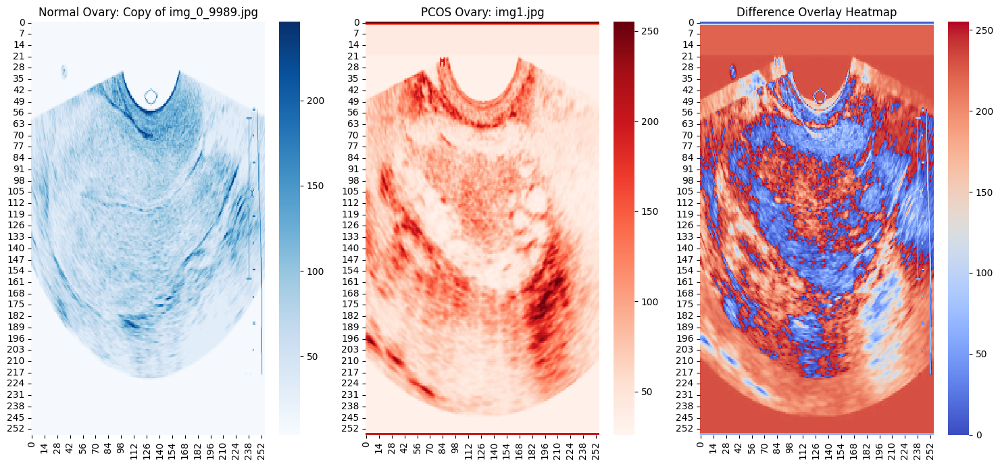

Processing: img1.jpeg vs. img10.jpg


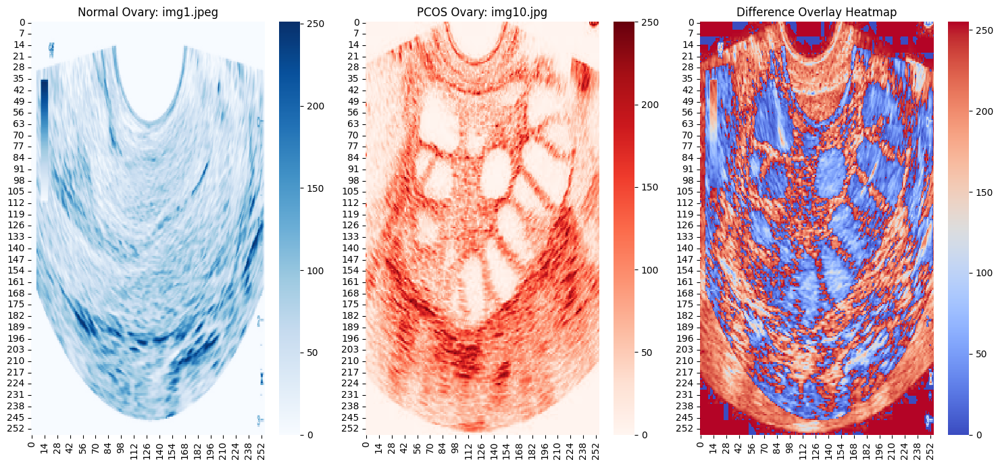

Processing: img2.png vs. img2.jpg


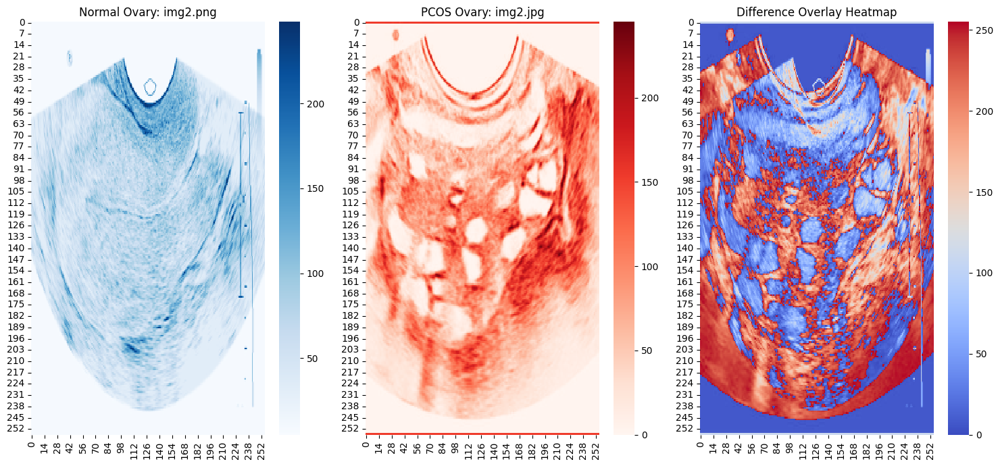

Processing: img3.jpg vs. img3.jpg


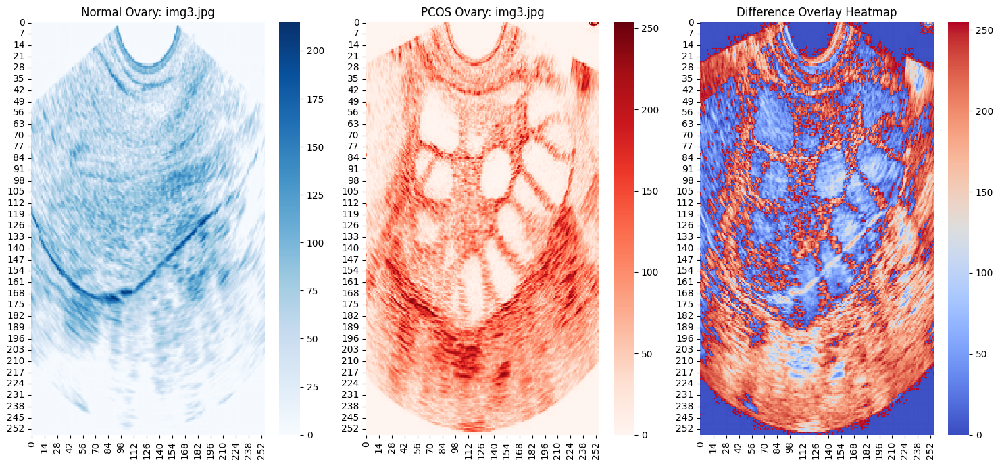

Processing: img4.jpg vs. img4.jpg


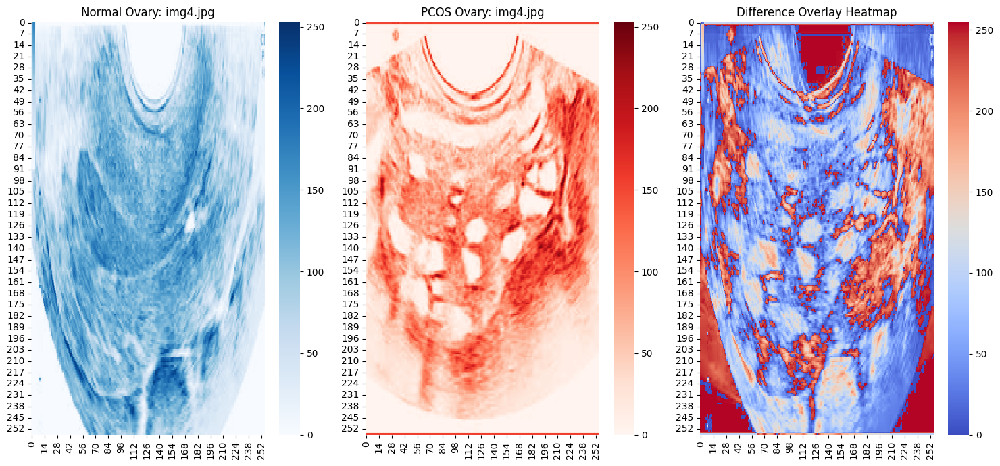

Processing: img_0_0.jpg vs. img5.jpg


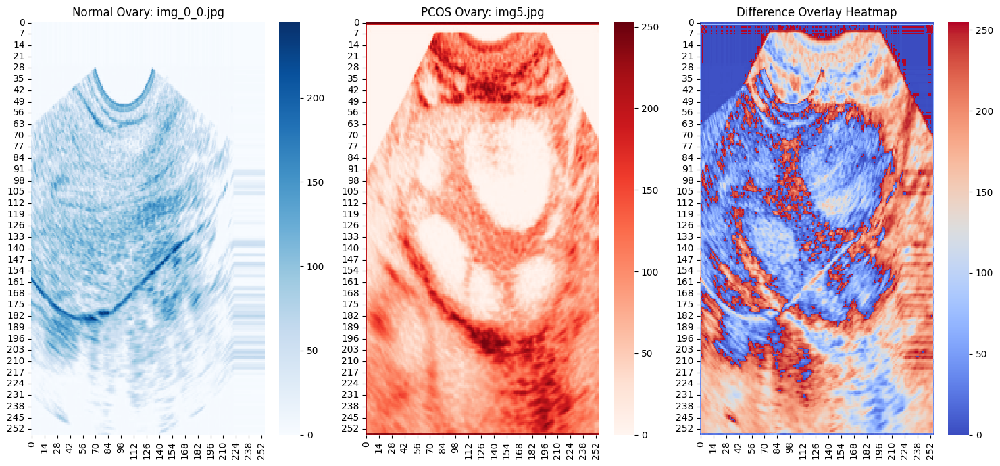

Processing: img_0_100.jpg vs. img6.jpg


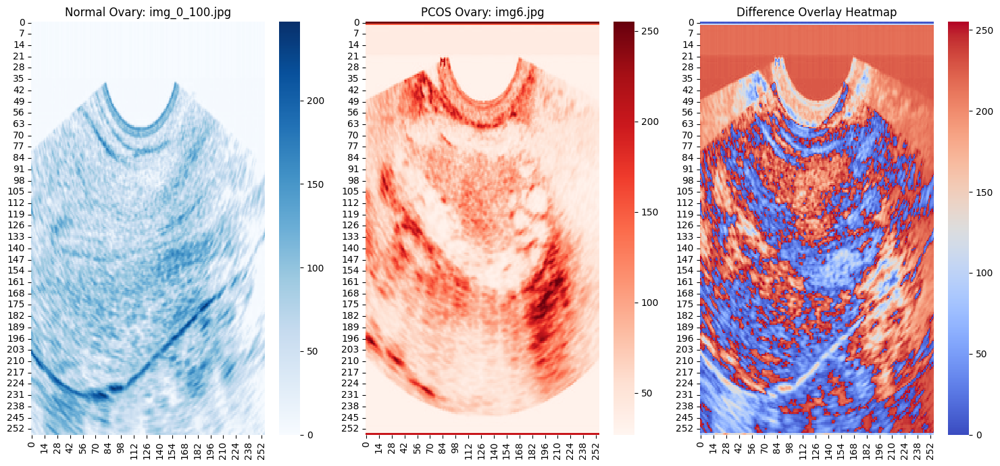

Processing: img_0_1012.jpg vs. img7.jpg


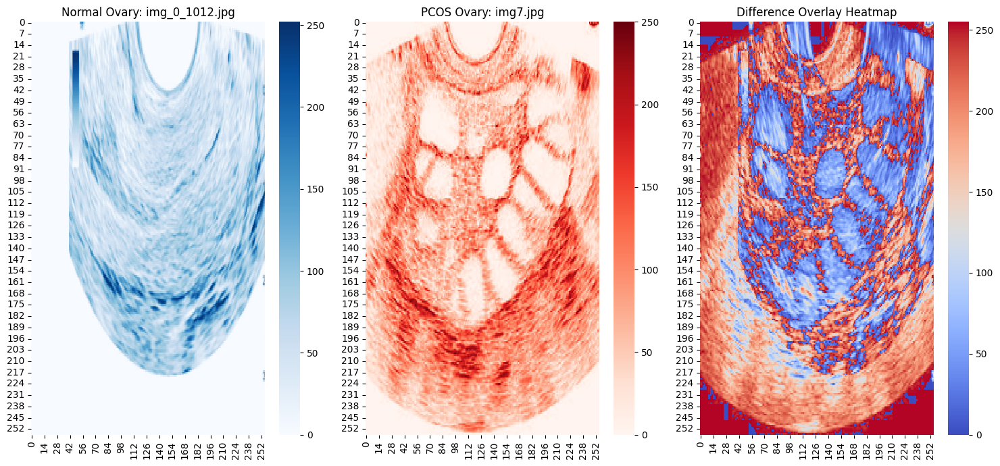

Processing: img_0_1015.jpg vs. img8.jpg


KeyboardInterrupt: 

In [ ]:
#5. Heatmap Comparison (Normal vs. PCOS)
import cv2
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
class PCOSComparison:
    def __init__(self, normal_directory, pcos_directory):
        self.normal_directory = normal_directory
        self.pcos_directory = pcos_directory
        self.target_size = (256, 256)
    def process_images_in_directory(self):
        """Process all images in the directories."""
        normal_images = sorted(os.listdir(self.normal_directory))
        pcos_images = sorted(os.listdir(self.pcos_directory))
        if len(normal_images) != len(pcos_images):
            print("Warning: Mismatch in the number of images between normal and PCOS directories.")
        for normal_file, pcos_file in zip(normal_images, pcos_images):
            normal_path = os.path.join(self.normal_directory, normal_file)
            pcos_path = os.path.join(self.pcos_directory, pcos_file)
            print(f"Processing: {normal_file} vs. {pcos_file}")
            self.compare_images(normal_path, pcos_path)

    def compare_images(self, normal_path, pcos_path):

        normal_image = cv2.imread(normal_path, cv2.IMREAD_GRAYSCALE)
        pcos_image = cv2.imread(pcos_path, cv2.IMREAD_GRAYSCALE)

        if normal_image is None or pcos_image is None:
            print(f"Error loading images: {normal_path} or {pcos_path}")
            return

        # Resize images
        normal_image = cv2.resize(normal_image, self.target_size, interpolation=cv2.INTER_AREA)
        pcos_image = cv2.resize(pcos_image, self.target_size, interpolation=cv2.INTER_AREA)

        # Plot heatmaps
        self.plot_heatmaps(normal_image, pcos_image, normal_path, pcos_path)

    def plot_heatmaps(self, normal_image, pcos_image, normal_path, pcos_path):

        plt.figure(figsize=(15, 7))
        plt.subplot(1, 3, 1)
        sns.heatmap(normal_image, cmap="Blues", cbar=True)
        plt.title(f"Normal Ovary: {os.path.basename(normal_path)}")

        # Heatmap for PCOS Ovary
        plt.subplot(1, 3, 2)
        sns.heatmap(pcos_image, cmap="Reds", cbar=True)
        plt.title(f"PCOS Ovary: {os.path.basename(pcos_path)}")

        # Heatmap for Differences
        difference = np.abs(normal_image - pcos_image)
        plt.subplot(1, 3, 3)
        sns.heatmap(difference, cmap="coolwarm", cbar=True)
        plt.title("Difference Overlay Heatmap")

        plt.tight_layout()
        plt.show()
normal_directory = '/content/drive/MyDrive/extracted_files/dataset/normal'
pcos_directory = '/content/drive/MyDrive/extracted_files/dataset/pcos'
comparison = PCOSComparison(normal_directory, pcos_directory)
print(comparison.process_images_in_directory())



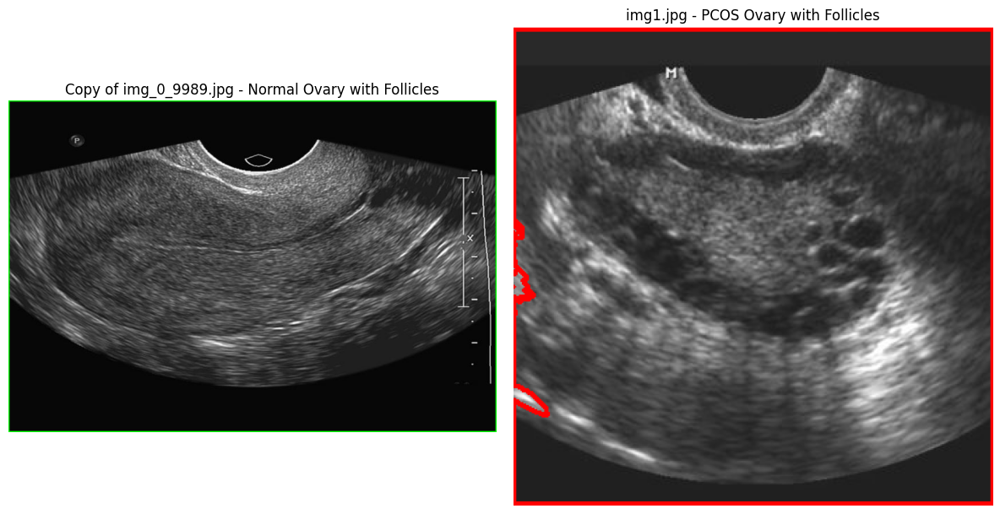

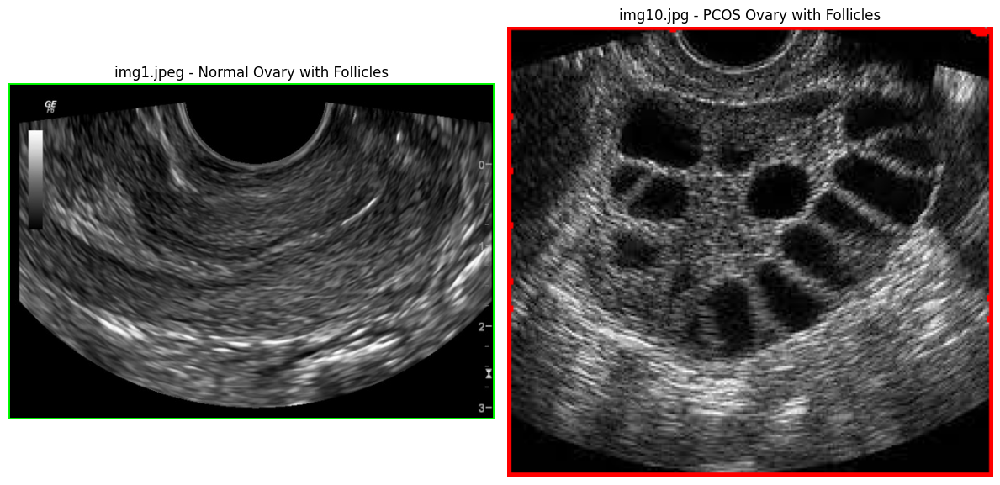

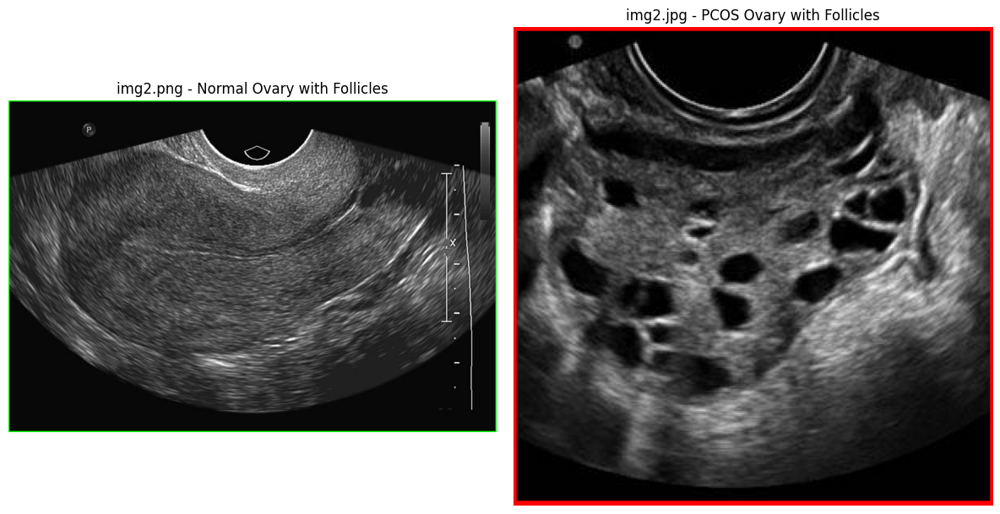

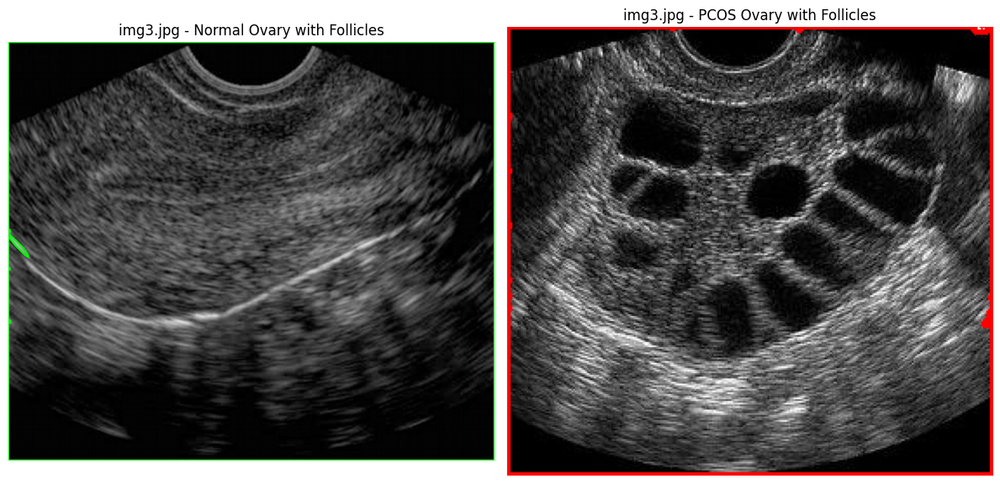

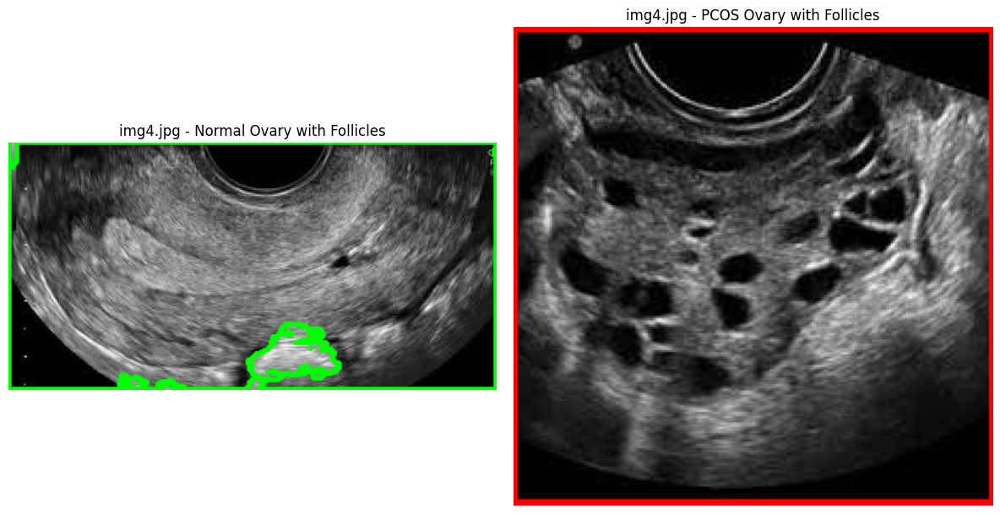

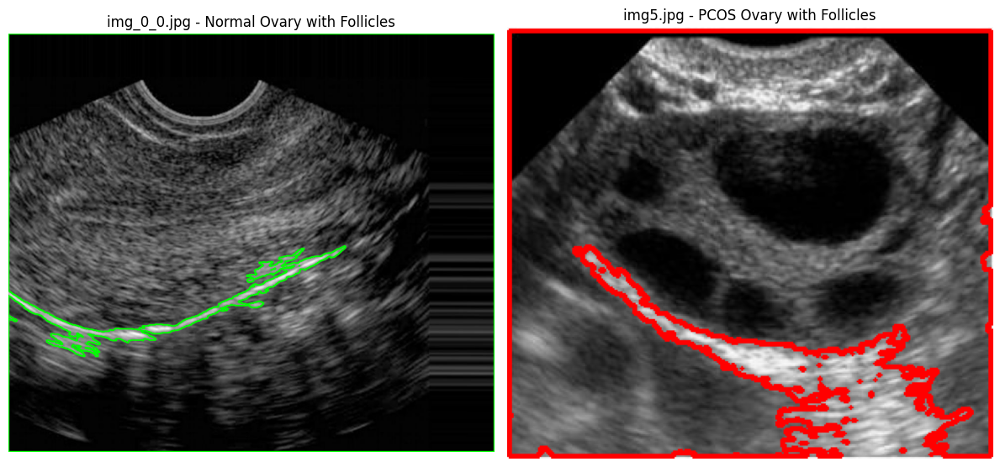

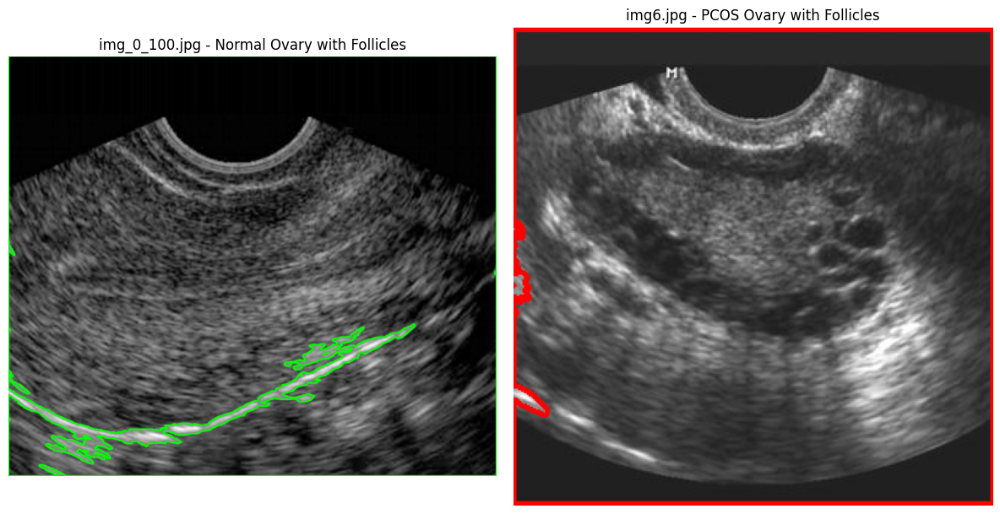

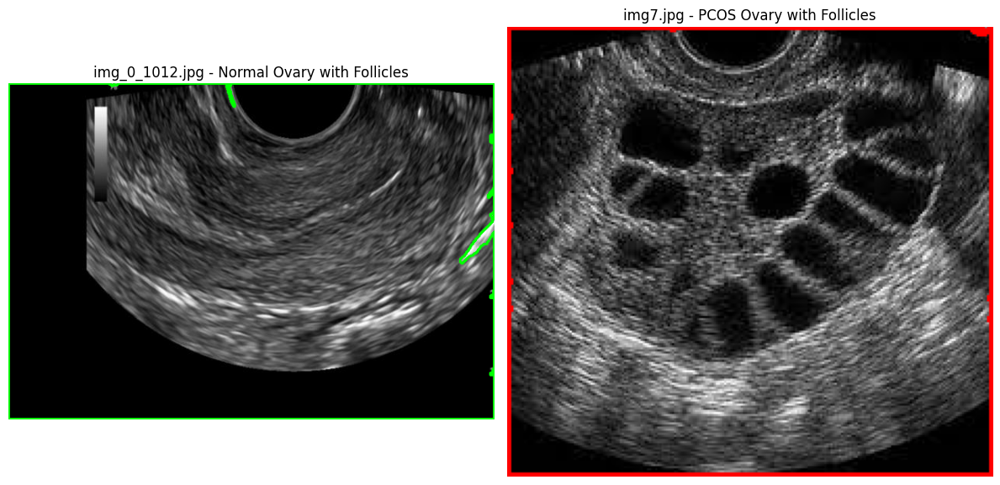

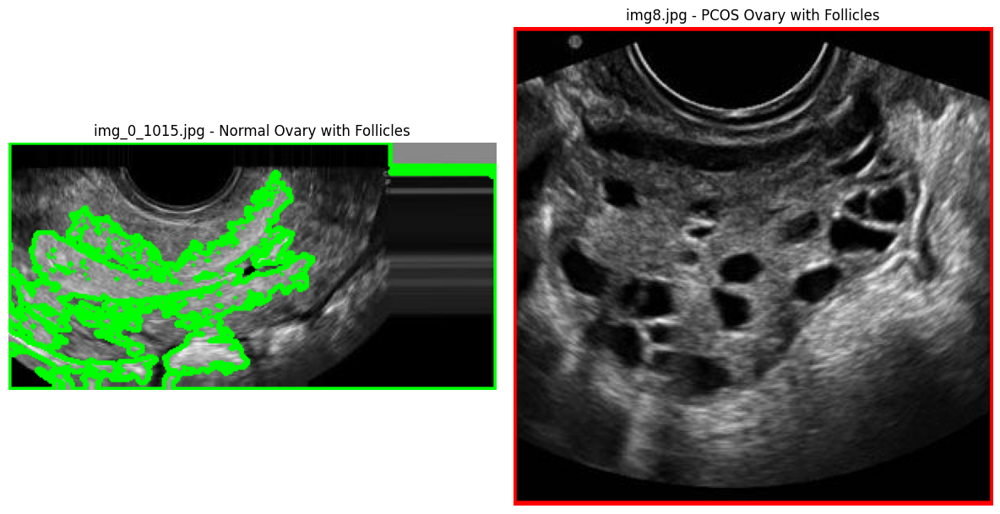

KeyboardInterrupt: 

In [ ]:
#6. Follicle Overlay and Highlighting
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

class OvaryAnalysis:
    def __init__(self, normal_directory, pcos_directory):
        self.normal_directory = normal_directory
        self.pcos_directory = pcos_directory
        self.normal_images = sorted(os.listdir(normal_directory))
        self.pcos_images = sorted(os.listdir(pcos_directory))

    def load_images(self, normal_image_path, pcos_image_path):
        # Load and convert to grayscale
        self.normal_image = cv2.imread(normal_image_path, cv2.IMREAD_GRAYSCALE)
        self.pcos_image = cv2.imread(pcos_image_path, cv2.IMREAD_GRAYSCALE)

    def process_image(self, image):
        # Apply thresholding to detect follicles
        _, thresh = cv2.threshold(image, 120, 255, cv2.THRESH_BINARY_INV)
        # Find contours (follicles)
        contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        return contours, thresh

    def analyze_images(self):
        # Process normal ovary
        normal_contours, _ = self.process_image(self.normal_image)
        # Process PCOS ovary
        pcos_contours, _ = self.process_image(self.pcos_image)

        # Draw contours on original images
        self.normal_overlay = cv2.cvtColor(self.normal_image, cv2.COLOR_GRAY2RGB)
        self.pcos_overlay = cv2.cvtColor(self.pcos_image, cv2.COLOR_GRAY2RGB)
        cv2.drawContours(self.normal_overlay, normal_contours, -1, (0, 255, 0), 2)  # Green for normal
        cv2.drawContours(self.pcos_overlay, pcos_contours, -1, (255, 0, 0), 2)  # Blue for PCOS
    def visualize_results(self, normal_image_name, pcos_image_name):
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))

        axes[0].imshow(self.normal_overlay)
        axes[0].set_title(f'{normal_image_name} - Normal Ovary with Follicles')
        axes[0].axis('off')

        axes[1].imshow(self.pcos_overlay)
        axes[1].set_title(f'{pcos_image_name} - PCOS Ovary with Follicles')
        axes[1].axis('off')

        plt.tight_layout()
        plt.show()

    def process_all_images(self):
        for normal_image_name, pcos_image_name in zip(self.normal_images, self.pcos_images):
            normal_image_path = os.path.join(self.normal_directory, normal_image_name)
            pcos_image_path = os.path.join(self.pcos_directory, pcos_image_name)

            self.load_images(normal_image_path, pcos_image_path)
            self.analyze_images()
            self.visualize_results(normal_image_name, pcos_image_name)
normal_directory = '/content/drive/MyDrive/extracted_files/dataset/normal'
pcos_directory = '/content/drive/MyDrive/extracted_files/dataset/pcos'
analysis = OvaryAnalysis(normal_directory, pcos_directory)
analysis.process_all_images()


In [ ]:
#7.Convert Image to DataFrame
import cv2
import pandas as pd
import numpy as np
import os

class ImageAnalysis:
    def __init__(self, normal_directory, pcos_directory):
        self.normal_directory = normal_directory
        self.pcos_directory = pcos_directory
        self.normal_dataframes = []
        self.pcos_dataframes = []

    def convert_image_to_dataframe(self, image_path):

        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        # Flatten the image into a 1D array of pixel intensities
        image_flat = image.flatten()

        # Create a pandas DataFrame with the pixel intensity values
        image_df = pd.DataFrame(image_flat, columns=['Pixel Intensity'])

        return image_df

    def process_images(self):
        """
        Process all images in the directories and convert them to DataFrames.
        """
        # List all the image files in the directories
        normal_images = sorted(os.listdir(self.normal_directory))
        pcos_images = sorted(os.listdir(self.pcos_directory))

        # Process normal images
        for normal_image in normal_images:
            normal_image_path = os.path.join(self.normal_directory, normal_image)
            normal_df = self.convert_image_to_dataframe(normal_image_path)
            normal_df['Class'] = 'Normal'  # Add class label
            self.normal_dataframes.append(normal_df)

        # Process PCOS images
        for pcos_image in pcos_images:
            pcos_image_path = os.path.join(self.pcos_directory, pcos_image)
            pcos_df = self.convert_image_to_dataframe(pcos_image_path)
            pcos_df['Class'] = 'PCOS'  # Add class label
            self.pcos_dataframes.append(pcos_df)

    def analyze_dataset(self):
        """
        Analyze the pixel intensity data by generating statistics for both normal and PCOS images.
        """
        # Combine normal and PCOS DataFrames
        all_data = pd.concat(self.normal_dataframes + self.pcos_dataframes, ignore_index=True)

        # Get basic statistics of the pixel intensity data
        statistics = all_data.groupby('Class')['Pixel Intensity'].describe()

        print("Pixel Intensity Statistics by Class (Normal vs. PCOS):")
        print(statistics)

        return statistics

normal_directory = '/content/drive/MyDrive/extracted_files/dataset/normal'  # Replace with the actual path to normal images
pcos_directory = '/content/drive/MyDrive/extracted_files/dataset/pcos'  # Replace with the actual path to PCOS images
analysis = ImageAnalysis(normal_directory, pcos_directory)
analysis.process_images()
statistics = analysis.analyze_dataset()




KeyboardInterrupt: 

In [ ]:
#8 Visualization and Analysis
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

class OvaryAnalysis:
    def __init__(self, normal_directory, pcos_directory):
        self.normal_directory = normal_directory
        self.pcos_directory = pcos_directory

        # Filter and load only image files
        self.normal_images = [
            f for f in sorted(os.listdir(normal_directory)) if f.lower().endswith(('.png', '.jpg', '.jpeg'))
        ]
        self.pcos_images = [
            f for f in sorted(os.listdir(pcos_directory)) if f.lower().endswith(('.png', '.jpg', '.jpeg'))
        ]

        if not self.normal_images or not self.pcos_images:
            raise ValueError("One or both directories do not contain valid images.")

        # Match image counts between the two datasets
        min_count = min(len(self.normal_images), len(self.pcos_images))
        self.normal_images = self.normal_images[:min_count]
        self.pcos_images = self.pcos_images[:min_count]

    def process_image(self, image_path):
        """
        Process a single image to grayscale and apply thresholding.
        """
        # Load and convert the image to grayscale
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        # Threshold to detect follicles (binary image)
        _, binary_image = cv2.threshold(image, 120, 255, cv2.THRESH_BINARY_INV)

        return image, binary_image

    def compare_original_augmented(self, batch_size=10):
        """
        Create comparison plots for original images in batches to avoid excessive figure size.
        """
        num_batches = (len(self.normal_images) + batch_size - 1) // batch_size

        for batch in range(num_batches):
            start = batch * batch_size
            end = min((batch + 1) * batch_size, len(self.normal_images))
            fig, axes = plt.subplots(end - start, 2, figsize=(12, 4 * (end - start)))

            for i, idx in enumerate(range(start, end)):
                normal_image_path = os.path.join(self.normal_directory, self.normal_images[idx])
                pcos_image_path = os.path.join(self.pcos_directory, self.pcos_images[idx])

                normal_img, _ = self.process_image(normal_image_path)
                pcos_img, _ = self.process_image(pcos_image_path)

                axes[i, 0].imshow(cv2.cvtColor(normal_img, cv2.COLOR_GRAY2RGB))
                axes[i, 0].set_title(f"Normal: {self.normal_images[idx]}")
                axes[i, 0].axis('off')

                axes[i, 1].imshow(cv2.cvtColor(pcos_img, cv2.COLOR_GRAY2RGB))
                axes[i, 1].set_title(f"PCOS: {self.pcos_images[idx]}")
                axes[i, 1].axis('off')

            plt.tight_layout()
            plt.show()

    def generate_colormap(self, batch_size=10):
        """
        Generate color maps to visualize differences in ovarian structures (e.g., follicles).
        """
        num_batches = (len(self.normal_images) + batch_size - 1) // batch_size

        for batch in range(num_batches):
            start = batch * batch_size
            end = min((batch + 1) * batch_size, len(self.normal_images))
            fig, axes = plt.subplots(end - start, 2, figsize=(12, 4 * (end - start)))

            for i, idx in enumerate(range(start, end)):
                normal_image_path = os.path.join(self.normal_directory, self.normal_images[idx])
                pcos_image_path = os.path.join(self.pcos_directory, self.pcos_images[idx])

                normal_img, normal_binary = self.process_image(normal_image_path)
                pcos_img, pcos_binary = self.process_image(pcos_image_path)

                normal_colormap = cv2.applyColorMap(normal_binary, cv2.COLORMAP_JET)
                pcos_colormap = cv2.applyColorMap(pcos_binary, cv2.COLORMAP_JET)

                axes[i, 0].imshow(cv2.cvtColor(normal_colormap, cv2.COLOR_BGR2RGB))
                axes[i, 0].set_title(f"Normal Colormap: {self.normal_images[idx]}")
                axes[i, 0].axis('off')

                axes[i, 1].imshow(cv2.cvtColor(pcos_colormap, cv2.COLOR_BGR2RGB))
                axes[i, 1].set_title(f"PCOS Colormap: {self.pcos_images[idx]}")
                axes[i, 1].axis('off')

            plt.tight_layout()
            plt.show()

    def overlay_follicles(self, batch_size=10):
        """
        Overlay visualizations to highlight follicle points and key differences.
        """
        num_batches = (len(self.normal_images) + batch_size - 1) // batch_size

        for batch in range(num_batches):
            start = batch * batch_size
            end = min((batch + 1) * batch_size, len(self.normal_images))
            fig, axes = plt.subplots(end - start, 2, figsize=(12, 4 * (end - start)))

            for i, idx in enumerate(range(start, end)):
                normal_image_path = os.path.join(self.normal_directory, self.normal_images[idx])
                pcos_image_path = os.path.join(self.pcos_directory, self.pcos_images[idx])

                normal_img, normal_binary = self.process_image(normal_image_path)
                pcos_img, pcos_binary = self.process_image(pcos_image_path)

                normal_overlay = cv2.cvtColor(normal_img, cv2.COLOR_GRAY2RGB)
                pcos_overlay = cv2.cvtColor(pcos_img, cv2.COLOR_GRAY2RGB)

                normal_contours, _ = cv2.findContours(normal_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                pcos_contours, _ = cv2.findContours(pcos_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

                cv2.drawContours(normal_overlay, normal_contours, -1, (0, 255, 0), 2)
                cv2.drawContours(pcos_overlay, pcos_contours, -1, (255, 0, 0), 2)

                axes[i, 0].imshow(cv2.cvtColor(normal_overlay, cv2.COLOR_BGR2RGB))
                axes[i, 0].set_title(f"Normal Ovary: {self.normal_images[idx]}")
                axes[i, 0].axis('off')

                axes[i, 1].imshow(cv2.cvtColor(pcos_overlay, cv2.COLOR_BGR2RGB))
                axes[i, 1].set_title(f"PCOS Ovary: {self.pcos_images[idx]}")
                axes[i, 1].axis('off')

            plt.tight_layout()
            plt.show()

# Usage example:
normal_directory = '/content/drive/MyDrive/extracted_files/dataset/normal'
pcos_directory = '/content/drive/MyDrive/extracted_files/dataset/pcos'

# Create an instance of the OvaryAnalysis class
analysis = OvaryAnalysis(normal_directory, pcos_directory)

# Perform analysis
analysis.compare_original_augmented(batch_size=10)
analysis.generate_colormap(batch_size=10)
analysis.overlay_follicles(batch_size=10)


In [ ]:
class Dog:
    def __init__(self, name, age):
        self.name = name
        self.age = age

    def bark(self):
        return f"{self.name} says woof!"

    def get_age(self):
        return f"{self.name} is {self.age} years old."

# Creating an instance of the Dog class
my_dog = Dog("Buddy", 3)

# Calling class functions
print(my_dog.bark())  # Output: Buddy says woof!
print(my_dog.get_age())  # Output: Buddy is 3 years old.


Buddy says woof!
Buddy is 3 years old.
